In [1]:
#!pip install git+https://github.com/xarray-contrib/xdggs.git

In [13]:
#!pip install git+https://github.com/IAOCEA/xarray-healpy.git

In [2]:
import xarray as xr
import xdggs
_ = xr.set_options(display_expand_data=False)

In [3]:
import gc
from distributed import Client, LocalCluster

In [4]:
import math
from datetime import datetime
import matplotlib.pyplot as plt
import numpy as np
import json, gcsfs
with open('pangeo-181919-e7bc5bdaf4d5.json') as f:
    token = json.load(f)
gcs = gcsfs.GCSFileSystem(token=token)

In [5]:
tmvelprodpath = "pangeo-argo-eke/TMVELPROD.zarr"
ds = xr.open_zarr(gcs.get_mapper(tmvelprodpath), consolidated=True)

In [6]:
nside = 512

In [7]:
def center_longitude(ds, center):
    if center == 0:
        centered = (ds.longitude + 180) % 360 - 180
    else:
        centered = (ds.longitude - 180) % 360 + 180
    return ds.assign_coords(longitude=centered)

In [8]:
from xarray_healpy import HealpyGridInfo, HealpyRegridder

In [10]:
# Define the target Healpix grid information
grid = HealpyGridInfo(level=int(np.log2(nside)))
target_grid = grid.target_grid(ds).pipe(center_longitude, 0).drop_attrs(deep=False).dggs.decode({"grid_name": "healpix", "nside": nside, "indexing_scheme": "nested"})

In [11]:
%%time
# Compute the interpolation weights for regridding the diff data
regridder = HealpyRegridder(
    ds[["longitude", "latitude"]].compute(),
    target_grid,
    method="bilinear",
    interpolation_kwargs={},
)
regridder

CPU times: user 19.3 s, sys: 1.72 s, total: 21 s
Wall time: 21 s


HealpyRegridder(method='bilinear', interpolation_kwargs={})

In [12]:
%%time
# Perform the regridding operation using the computed interpolation weights.
regridded = regridder.regrid_ds(ds).pipe(xdggs.decode)

CPU times: user 1.34 s, sys: 611 ms, total: 1.96 s
Wall time: 1.97 s


In [13]:
np.log(0.5 * (regridded.u**2 + regridded.v**2)).compute().squeeze().dggs.explore()

Map(layers=[SolidPolygonLayer(filled=True, get_fill_color=<pyarrow.lib.FixedSizeListArray object at 0x76629ce6…

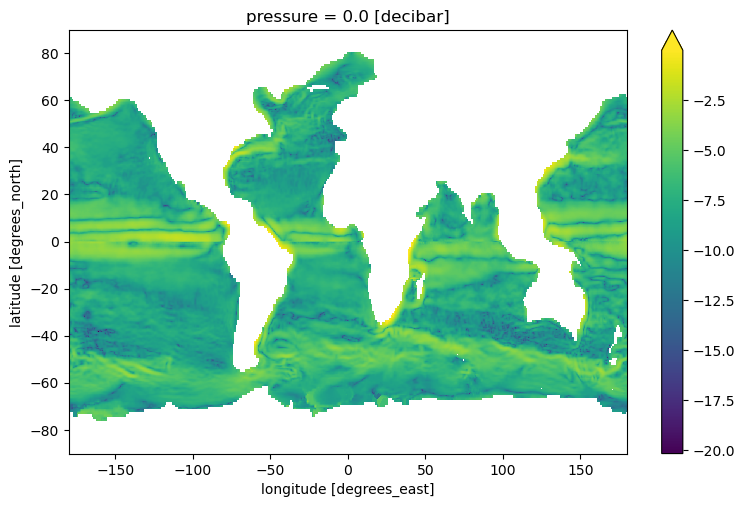

In [27]:
np.log(0.5 * (ds.u**2 + ds.v**2)).compute().plot(
    figsize=(9, 5.5), cmap="viridis", vmax=-0.01
)

In [23]:
import hvplot.xarray
import cartopy.crs as crs

np.log(0.5 * (ds.u**2 + ds.v**2)).compute().hvplot.quadmesh(
    'longitude', 'latitude', projection=crs.Orthographic(-90, 30), project=True,
    global_extent=True, cmap='viridis', coastline=True
)

:DynamicMap   [pressure]
   :Overlay
      .QuadMesh.I  :QuadMesh   [longitude,latitude]   (value)
      .Coastline.I :Feature   [Longitude,Latitude]